<font color="lightseagreen" size=+3.7><b>Periodic Table EDA & Cleaning</b></font>

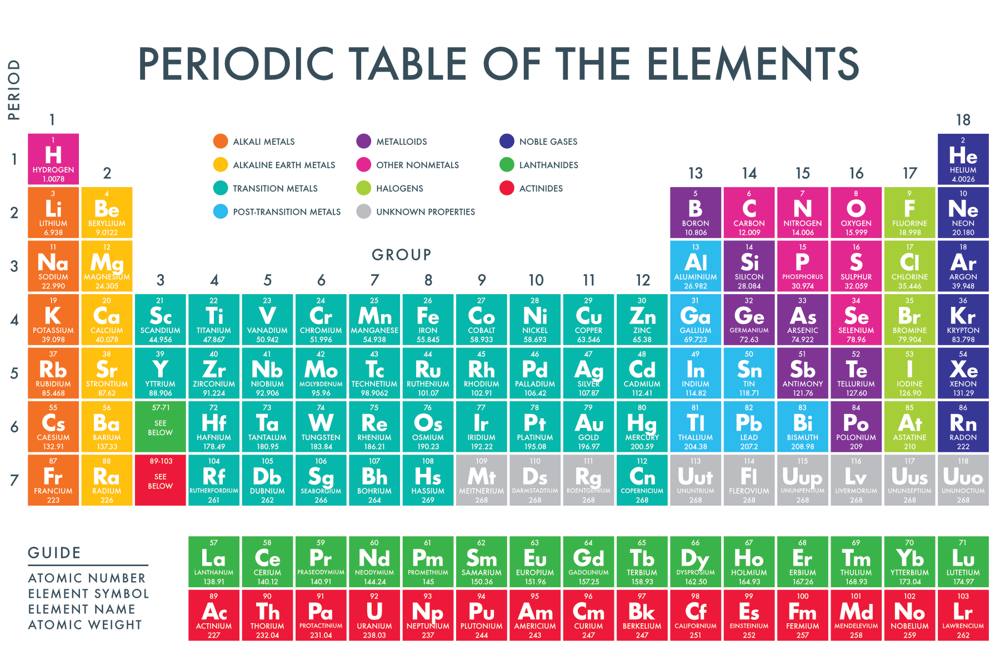

<font color="lightseagreen" size=+3.7><b>Table of Contents</b></font>

* [1. Problem Statement](#1)<br>
* [2. Data Description](#2)<br>
* [3. Importing packages](#3)<br/>
* [4. Data Loading](#4)<br/>
* [5. Exploratory Data Analysis (EDA)](#5)<br/>
    - * [Understanding the Dataset](#5.1)<br/>
    - * [Data Profiling](#5.2)<br/>
* [6. Data Cleaning](#6)<br/>
    - * [1. Columns Format](#6.1)<br/>
    - * [2. Drop Un-wanted columns](#6.2)<br/>
    - * [3. Nall values Handling](#6.3)<br/>
    - * [4. columns Name Handiling & Arrangement](#6.4)<br/>

<a id="1"></a>

<font color="lightseagreen" size=+2><b>1. Problem Statement</b></font> 

- The notebooks explores the basic use of __Pandas__ and will cover the basic commands of __(EDA & Cleaning)__ for analysis purpose.

- __In this study__, we will try to see if we can explore the __Metalorgy of elements__ and it's price based on different features. The features are different (__Chemical Nature__,Physical properties,Nature of Element...).

- The variables of the dataset are the following:

   * __Categorical__: ['Element','Symbol','Phase','Radioactive','Natural','Metal','Nonmetal','Metalloid','Type','Discoverer']
   * __Date__: ‘Year of element descoverinf’
   * __Numerical__:['AtomicNumber', 'AtomicMass', 'NumberofNeutrons',
       'NumberofProtons', 'NumberofElectrons', 'Period', 'Group',
       'AtomicRadius', 'Electronegativity', 'FirstIonization', 'Density',
       'MeltingPoint', 'BoilingPoint', 'NumberOfIsotopes', 'SpecificHeat', 'NumberofShells', 'NumberofValence']
   * __Target__:‘’The price of __Metal Elements Variation__ based on their properties ’

<a id="2"></a>

<font color="lightseagreen" size=+2><b>2. Data Description</b></font>

- this data is consist of  merging of two csv files :
  * one from kaggle:  https://www.kaggle.com/datasets/psycon/periodic 
  * other from this website: http://www.leonland.de/elements_by_price/en/list
by web scraping 
- The dataset comprises of __118 rows & 28 columns__. Below is a table showing names of all the columns and their description.

### *The unclear variables terminology is explained in the next section:


| Column                | Description                                                    |
|-----------------------|----------------------------------------------------------------|
| Atomic Number         | Integer identifier for an element in the periodic table.        |
| Element               | Name of the chemical element.                                   |
| Symbol                | The unique symbol used to represent the element.                |
| Atomic Mass           | The average atomic mass of the element.                         |
| Number of Neutrons    | The count of neutrons within the element's nucleus.             |
| Number of Protons     | The number of protons in the nucleus, defining the element.     |
| Number of Electrons   | The total count of electrons in a neutral atom of the element.   |
| Period                | The period or row in the periodic table where the element is placed. |
| Group                 | The group or column where the element is positioned in the periodic table. |
| Phase                 | State of matter the element exists in at room temperature.      |
| Radioactive           | Indication of whether the element is radioactive.               |
| Natural               | A boolean indicating if the element is naturally occurring.     |
| Metal                 | Categories defining the element's chemical nature.              |
| Nonmetal              | Categories defining the element's chemical nature.              |
| Metalloid             | Categories defining the element's chemical nature.              |
| Type                  | Categorization of the element's properties.                    |
| Electronegativity     | A measure of the element's tendency to attract electrons.       |
| First Ionization      | The amount of energy required to remove the outermost electron. |
| Density               | The density of the element.                                    |
| Melting Point         | Temperature at which the element transitions from solid to liquid. |
| Boiling Point         | Temperature at which the element transitions from liquid to gas. |
| Number Of Isotopes    | Count of different isotopes for the element.                    |
| Discoverer            | Scientist or individual credited with the element's discovery. |
| Year                  | The year in which the element was discovered.                   |
| Specific Heat         | The amount of heat required to raise the temperature of the element. |
| Number of Shells      | The count of electron shells in an atom.                        |
| Number of Valence     | The number of valence electrons present in an atom.             |
| PriceUSD / kg      | Price of the element per kilogram.   |
| Reference price    | Reference price of the element.      |

<a id="3"></a>

<font color="lightseagreen" size=+2><b>3. Importing packages</b></font>

In [1]:
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport

#plotly
import plotly.express as px 
import plotly.figure_factory as ff
import plotly.graph_objs as po

In [2]:
pd.set_option('display.max_columns',40)

<a id="4"></a>

<font color="lightseagreen" size=+2><b>4. Data Loading</b></font>

In [3]:
raw_df=pd.read_csv('../data/raw/raw.csv')

In [4]:
raw_df.head()

,Unnamed: 0,Symbol_x,Element,PriceUSD / kg,Reference price,Reference price.1,AtomicNumber,Symbol_y,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Metal,Nonmetal,Metalloid,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence
0,0,H,Hydrogen,23.64,0.06,USD per standard cubic foot (scf),1.0,H,1.007,0.0,1.0,1.0,1.0,1.0,gas,NaN,yes,NaN,yes,NaN,Nonmetal,0.79,2.20,13.5984,0.000090,14.175,20.28,3.0,Cavendish,1766.0,14.304,1.0,1.0
1,1,He,Helium,40.39,7.21,USD per normal cubic meter,2.0,He,4.002,2.0,2.0,2.0,1.0,18.0,gas,NaN,yes,NaN,yes,NaN,Noble Gas,0.49,NaN,24.5874,0.000179,NaN,4.22,5.0,Janssen,1868.0,5.193,1.0,NaN
2,2,Li,Lithium,115.70,"800,000.00",CNY per metric ton,3.0,Li,6.941,4.0,3.0,3.0,2.0,1.0,solid,NaN,yes,yes,NaN,NaN,Alkali Metal,2.10,0.98,5.3917,0.534000,453.850,1615.00,5.0,Arfvedson,1817.0,3.582,2.0,1.0
3,3,Be,Beryllium,831.60,"5,750.00",CNY per kilogram,4.0,Be,9.012,5.0,4.0,4.0,2.0,2.0,solid,NaN,yes,yes,NaN,NaN,Alkaline Earth Metal,1.40,1.57,9.3227,1.850000,1560.150,2742.00,6.0,Vaulquelin,1798.0,1.825,2.0,2.0
4,4,B,Boron,"2,386.00","16,500.00",CNY per kilogram,5.0,B,10.811,6.0,5.0,5.0,2.0,13.0,solid,NaN,yes,NaN,NaN,yes,Metalloid,1.20,2.04,8.2980,2.340000,2573.150,4200.00,6.0,Gay-Lussac,1808.0,1.026,2.0,3.0


In [5]:
df=raw_df.copy()

<a id="5"></a>

<font color="lightseagreen" size=+2><b>5. Exploratory Data Analysis (EDA)</b></font>

<a id="5.1"></a>

<font color="lightseagreen" size=+0.5><b>5.1. Understanding the Periodic Table </b></font>

In [6]:
df.shape

(118, 33)

- There are [118 row(elements)] & [35 column==>some of them is to drop] lets go to __Explore__ them📊📈😶‍🌫️

In [7]:
df.head(3)

,Unnamed: 0,Symbol_x,Element,PriceUSD / kg,Reference price,Reference price.1,AtomicNumber,Symbol_y,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Metal,Nonmetal,Metalloid,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence
0,0,H,Hydrogen,23.64,0.06,USD per standard cubic foot (scf),1.0,H,1.007,0.0,1.0,1.0,1.0,1.0,gas,NaN,yes,NaN,yes,NaN,Nonmetal,0.79,2.20,13.5984,0.000090,14.175,20.28,3.0,Cavendish,1766.0,14.304,1.0,1.0
1,1,He,Helium,40.39,7.21,USD per normal cubic meter,2.0,He,4.002,2.0,2.0,2.0,1.0,18.0,gas,NaN,yes,NaN,yes,NaN,Noble Gas,0.49,NaN,24.5874,0.000179,NaN,4.22,5.0,Janssen,1868.0,5.193,1.0,NaN
2,2,Li,Lithium,115.70,"800,000.00",CNY per metric ton,3.0,Li,6.941,4.0,3.0,3.0,2.0,1.0,solid,NaN,yes,yes,NaN,NaN,Alkali Metal,2.10,0.98,5.3917,0.534000,453.850,1615.00,5.0,Arfvedson,1817.0,3.582,2.0,1.0


In [8]:
df.tail(3)

,Unnamed: 0,Symbol_x,Element,PriceUSD / kg,Reference price,Reference price.1,AtomicNumber,Symbol_y,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Metal,Nonmetal,Metalloid,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence
115,115,Lv,Livermorium,price unknown,NaN,NaN,116.0,Lv,292.0,176.0,116.0,116.0,7.0,16.0,artificial,yes,NaN,yes,NaN,NaN,Transactinide,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.0,NaN,7.0,6.0
116,116,Ts,Tennessine,price unknown,NaN,NaN,117.0,Ts,295.0,178.0,117.0,117.0,7.0,17.0,artificial,yes,NaN,NaN,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010.0,NaN,7.0,7.0
117,117,Og,Oganesson,price unknown,NaN,NaN,118.0,Og,294.0,176.0,118.0,118.0,7.0,18.0,artificial,yes,NaN,NaN,yes,NaN,Noble Gas,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2006.0,NaN,7.0,8.0


In [9]:
df.sample(5)

,Unnamed: 0,Symbol_x,Element,PriceUSD / kg,Reference price,Reference price.1,AtomicNumber,Symbol_y,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Metal,Nonmetal,Metalloid,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence
23,23,Cr,Chromium,7.64,"7,641.67",USD per metric ton,24.0,Cr,51.996,28.0,24.0,24.0,4.0,6.0,solid,NaN,yes,yes,NaN,NaN,Transition Metal,1.90,1.66,6.7665,7.15000,2130.15,2944.0,9.0,Vauquelin,1797.0,0.449,4.0,NaN
7,7,O,Oxygen,0.64,0.02,USD per standard cubic foot (scf),8.0,O,15.999,8.0,8.0,8.0,2.0,16.0,gas,NaN,yes,NaN,yes,NaN,Nonmetal,0.65,3.44,13.6181,0.00143,50.50,90.2,8.0,Priestley/Scheele,1774.0,0.918,2.0,6.0
101,101,No,Nobelium,price unknown,NaN,NaN,102.0,No,259.000,157.0,102.0,102.0,7.0,NaN,artificial,yes,NaN,yes,NaN,NaN,Actinide,NaN,1.30,6.6500,NaN,NaN,NaN,73.0,Ghiorso et al.,1958.0,NaN,7.0,NaN
55,55,Ba,Barium,550.00,55.00,USD per 100 grams,56.0,Ba,137.327,81.0,56.0,56.0,6.0,2.0,solid,NaN,yes,yes,NaN,NaN,Alkaline Earth Metal,2.80,0.89,5.2117,3.59000,1002.15,2170.0,25.0,Davy,1808.0,0.204,6.0,2.0
57,57,Ce,Cerium,7.00,7.00,USD per kilogram,58.0,Ce,140.116,82.0,58.0,58.0,6.0,NaN,solid,NaN,yes,yes,NaN,NaN,Lanthanide,2.70,1.12,5.5387,6.77000,1071.15,3716.0,19.0,Berzelius,1803.0,0.192,6.0,NaN


In [10]:
df.info() # This will give Index, Datatype and Memory information

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118 entries, 0 to 117
Data columns (total 33 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         118 non-null    int64  
 1   Symbol_x           118 non-null    object 
 2   Element            118 non-null    object 
 3   PriceUSD / kg      118 non-null    object 
 4   Reference price    83 non-null     object 
 5   Reference price.1  83 non-null     object 
 6   AtomicNumber       111 non-null    float64
 7   Symbol_y           111 non-null    object 
 8   AtomicMass         111 non-null    float64
 9   NumberofNeutrons   111 non-null    float64
 10  NumberofProtons    111 non-null    float64
 11  NumberofElectrons  111 non-null    float64
 12  Period             111 non-null    float64
 13  Group              84 non-null     float64
 14  Phase              111 non-null    object 
 15  Radioactive        33 non-null     object 
 16  Natural            86 non-

- __Year__ ==> we can convert it's __type__ from float to integer
- __Price USD/kg__ ==>we can convert it's __type__ from object to integer

In [11]:
df.isna().sum()

Unnamed: 0             0
Symbol_x               0
Element                0
PriceUSD / kg          0
Reference price       35
Reference price.1     35
AtomicNumber           7
Symbol_y               7
AtomicMass             7
NumberofNeutrons       7
NumberofProtons        7
NumberofElectrons      7
Period                 7
Group                 34
Phase                  7
Radioactive           85
Natural               32
Metal                 33
Nonmetal              99
Metalloid            111
Type                  10
AtomicRadius          35
Electronegativity     26
FirstIonization       20
Density               17
MeltingPoint          24
BoilingPoint          24
NumberOfIsotopes      19
Discoverer            13
Year                  18
SpecificHeat          37
NumberofShells         7
NumberofValence       71
dtype: int64

- There are some __missing values__ to handling as we __need__ not to removing😒

In [12]:
df.duplicated().sum()

0

- No douplicated values 👌😁

In [13]:
df.columns

Index(['Unnamed: 0', 'Symbol_x', 'Element', 'PriceUSD / kg', 'Reference price',
       'Reference price.1', 'AtomicNumber', 'Symbol_y', 'AtomicMass',
       'NumberofNeutrons', 'NumberofProtons', 'NumberofElectrons', 'Period',
       'Group', 'Phase', 'Radioactive', 'Natural', 'Metal', 'Nonmetal',
       'Metalloid', 'Type', 'AtomicRadius', 'Electronegativity',
       'FirstIonization', 'Density', 'MeltingPoint', 'BoilingPoint',
       'NumberOfIsotopes', 'Discoverer', 'Year', 'SpecificHeat',
       'NumberofShells', 'NumberofValence'],
      dtype='object')

- we can see:
  * ['Unnamed: 0', 'Symbol_x', 'AtomicNumber'] ==> __is to drop__
  * ['Metal', 'Nonmetal','Metalloid'] ==> __is to concate in one column__
  * [Reference price','Reference price.1'] ==> __is to concate in one column__

In [14]:
df.describe().round(1)  #descriptive statistics specifically for columns containing numerical data 

,Unnamed: 0,AtomicNumber,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Year,SpecificHeat,NumberofShells,NumberofValence
count,118.0,111.0,111.0,111.0,111.0,111.0,111.0,84.0,83.0,92.0,98.0,101.0,94.0,94.0,99.0,100.0,81.0,111.0,47.0
mean,58.5,58.1,142.5,84.3,58.1,58.1,5.2,10.0,1.8,1.7,8.1,9.2,1268.8,2471.5,28.6,1862.9,0.7,5.2,4.5
std,34.2,33.8,87.9,54.2,33.8,33.8,1.6,5.7,0.6,0.6,3.4,8.6,882.0,1578.2,36.5,98.3,1.7,1.6,2.3
min,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.5,0.7,4.1,0.0,14.2,4.2,3.0,1250.0,0.1,1.0,1.0
25%,29.2,29.5,64.5,35.0,29.5,29.5,4.0,5.0,1.4,1.2,6.0,3.0,510.7,1069.0,11.0,1803.0,0.2,4.0,2.5
50%,58.5,58.0,140.1,82.0,58.0,58.0,6.0,10.5,1.8,1.6,7.2,7.3,1204.2,2609.5,19.0,1878.0,0.2,6.0,5.0
75%,87.8,86.5,222.5,136.0,86.5,86.5,6.5,15.0,2.2,2.1,9.0,11.9,1811.2,3556.5,24.5,1939.2,0.5,6.5,6.5
max,117.0,118.0,295.0,178.0,118.0,118.0,7.0,18.0,3.0,4.0,24.6,41.0,3948.2,5869.0,203.0,2010.0,14.3,7.0,8.0


- looks like it's some proplem in __count__ according to missing values 🙄

In [15]:
df.describe(include=['O']) #descriptive statistics specifically for columns containing categorical data 

,Symbol_x,Element,PriceUSD / kg,Reference price,Reference price.1,Symbol_y,Phase,Radioactive,Natural,Metal,Nonmetal,Metalloid,Type,Discoverer
count,118,118,118,83,83,111,111,33,86,85,19,7,108,105
unique,118,118,81,79,14,111,4,1,1,1,1,1,11,68
top,H,Hydrogen,price unknown,160.00,USD per kilogram,H,solid,yes,yes,yes,yes,yes,Transition Metal,Prehistoric
freq,1,1,35,2,26,1,73,33,86,85,19,7,28,10


__categorical data__:[	Symbol_x, Element,	PriceUSD / kg,	Reference price, Reference price.1,	Symbol_y,	Phase,	Radioactive,	Natural	Metal,	Nonmetal,	Metalloid,	Type,	Discoverer]

<a id="5.2"></a>

<font color="lightseagreen" size=+0.5><b>5.2. Data profiling</b></font>

In [16]:
profile = ProfileReport(df, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<a id="6"></a>

<font color="lightseagreen" size=+2><b>6. Data Cleaning</b></font>

<a id="6.1"></a>

<font color="lightseagreen" size=+0.5><b>6.1. Columns Formate</b></font>

In [17]:
df.columns

Index(['Unnamed: 0', 'Symbol_x', 'Element', 'PriceUSD / kg', 'Reference price',
       'Reference price.1', 'AtomicNumber', 'Symbol_y', 'AtomicMass',
       'NumberofNeutrons', 'NumberofProtons', 'NumberofElectrons', 'Period',
       'Group', 'Phase', 'Radioactive', 'Natural', 'Metal', 'Nonmetal',
       'Metalloid', 'Type', 'AtomicRadius', 'Electronegativity',
       'FirstIonization', 'Density', 'MeltingPoint', 'BoilingPoint',
       'NumberOfIsotopes', 'Discoverer', 'Year', 'SpecificHeat',
       'NumberofShells', 'NumberofValence'],
      dtype='object')

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118 entries, 0 to 117
Data columns (total 33 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         118 non-null    int64  
 1   Symbol_x           118 non-null    object 
 2   Element            118 non-null    object 
 3   PriceUSD / kg      118 non-null    object 
 4   Reference price    83 non-null     object 
 5   Reference price.1  83 non-null     object 
 6   AtomicNumber       111 non-null    float64
 7   Symbol_y           111 non-null    object 
 8   AtomicMass         111 non-null    float64
 9   NumberofNeutrons   111 non-null    float64
 10  NumberofProtons    111 non-null    float64
 11  NumberofElectrons  111 non-null    float64
 12  Period             111 non-null    float64
 13  Group              84 non-null     float64
 14  Phase              111 non-null    object 
 15  Radioactive        33 non-null     object 
 16  Natural            86 non-

In [19]:
df.head(3)

,Unnamed: 0,Symbol_x,Element,PriceUSD / kg,Reference price,Reference price.1,AtomicNumber,Symbol_y,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Metal,Nonmetal,Metalloid,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence
0,0,H,Hydrogen,23.64,0.06,USD per standard cubic foot (scf),1.0,H,1.007,0.0,1.0,1.0,1.0,1.0,gas,NaN,yes,NaN,yes,NaN,Nonmetal,0.79,2.20,13.5984,0.000090,14.175,20.28,3.0,Cavendish,1766.0,14.304,1.0,1.0
1,1,He,Helium,40.39,7.21,USD per normal cubic meter,2.0,He,4.002,2.0,2.0,2.0,1.0,18.0,gas,NaN,yes,NaN,yes,NaN,Noble Gas,0.49,NaN,24.5874,0.000179,NaN,4.22,5.0,Janssen,1868.0,5.193,1.0,NaN
2,2,Li,Lithium,115.70,"800,000.00",CNY per metric ton,3.0,Li,6.941,4.0,3.0,3.0,2.0,1.0,solid,NaN,yes,yes,NaN,NaN,Alkali Metal,2.10,0.98,5.3917,0.534000,453.850,1615.00,5.0,Arfvedson,1817.0,3.582,2.0,1.0


In [20]:
df.columns

Index(['Unnamed: 0', 'Symbol_x', 'Element', 'PriceUSD / kg', 'Reference price',
       'Reference price.1', 'AtomicNumber', 'Symbol_y', 'AtomicMass',
       'NumberofNeutrons', 'NumberofProtons', 'NumberofElectrons', 'Period',
       'Group', 'Phase', 'Radioactive', 'Natural', 'Metal', 'Nonmetal',
       'Metalloid', 'Type', 'AtomicRadius', 'Electronegativity',
       'FirstIonization', 'Density', 'MeltingPoint', 'BoilingPoint',
       'NumberOfIsotopes', 'Discoverer', 'Year', 'SpecificHeat',
       'NumberofShells', 'NumberofValence'],
      dtype='object')

- __['Metal','Nonmetal','Metalloid']__ ==> is to concate as a one column with name __[ChemicalNature]__

In [21]:
df[['Metal','Nonmetal','Metalloid']]

,Metal,Nonmetal,Metalloid
0,NaN,yes,NaN
1,NaN,yes,NaN
2,yes,NaN,NaN
3,yes,NaN,NaN
4,NaN,NaN,yes
...,...,...,...
113,yes,NaN,NaN
114,yes,NaN,NaN
115,yes,NaN,NaN
116,NaN,yes,NaN


In [22]:
df['Metal'].value_counts()

Metal
yes    85
Name: count, dtype: int64

In [23]:
df['Nonmetal'].value_counts()

Nonmetal
yes    19
Name: count, dtype: int64

In [24]:
df['Metalloid'].value_counts()

Metalloid
yes    7
Name: count, dtype: int64

In [25]:
def map_metal(x):
    if x=='yes':
        return 'Metal'
df['Metal']=df['Metal'].apply(lambda x: map_metal(x))

In [26]:
df['Metal'].unique()

array([None, 'Metal'], dtype=object)

In [27]:
def map_nonmetal(x):
    if x=='yes':
        return 'NonMetal'
df['Nonmetal']=df['Nonmetal'].apply(lambda x: map_nonmetal(x) )

In [28]:
df['Nonmetal'].unique()

array(['NonMetal', None], dtype=object)

In [29]:
def map_Metalloid(x):
    if x=='yes':
        return 'Metalloid'
df['Metalloid']=df['Metalloid'].apply(lambda x: map_Metalloid(x))

In [30]:
df['Metalloid'].unique()

array([None, 'Metalloid'], dtype=object)

In [31]:
df1=df[['Metal','Nonmetal','Metalloid']]
df1

,Metal,Nonmetal,Metalloid
0,None,NonMetal,None
1,None,NonMetal,None
2,Metal,None,None
3,Metal,None,None
4,None,None,Metalloid
...,...,...,...
113,Metal,None,None
114,Metal,None,None
115,Metal,None,None
116,None,NonMetal,None


In [32]:
df1['ChemicalNature'] = df1.apply(lambda x: ', '.join(x.dropna().astype(str)), axis=1)
df1['ChemicalNature'].reset_index()

,index,ChemicalNature
0,0,NonMetal
1,1,NonMetal
2,2,Metal
3,3,Metal
4,4,Metalloid
...,...,...
113,113,Metal
114,114,Metal
115,115,Metal
116,116,NonMetal


In [33]:
df1['ChemicalNature'].value_counts()

ChemicalNature
Metal        85
NonMetal     19
Metalloid     7
              7
Name: count, dtype: int64

In [34]:
df['ChemicalNature']=df1['ChemicalNature'].values

In [35]:
df1['ChemicalNature'].unique()

array(['NonMetal', 'Metal', 'Metalloid', ''], dtype=object)

In [36]:
df['ChemicalNature'] = df['ChemicalNature'].replace('', 'Unknown')

In [37]:
df1['ChemicalNature'].unique()

array(['NonMetal', 'Metal', 'Metalloid', ''], dtype=object)

In [38]:
df['ChemicalNature'].unique()

array(['NonMetal', 'Metal', 'Metalloid', 'Unknown'], dtype=object)

In [39]:
df.sample(5)

,Unnamed: 0,Symbol_x,Element,PriceUSD / kg,Reference price,Reference price.1,AtomicNumber,Symbol_y,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Metal,Nonmetal,Metalloid,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence,ChemicalNature
101,101,No,Nobelium,price unknown,NaN,NaN,102.0,No,259.000,157.0,102.0,102.0,7.0,NaN,artificial,yes,NaN,Metal,None,None,Actinide,NaN,1.30,6.6500,NaN,NaN,NaN,73.0,Ghiorso et al.,1958.0,NaN,7.0,NaN,Metal
86,86,Fr,Francium,price unknown,NaN,NaN,87.0,Fr,223.000,136.0,87.0,87.0,7.0,1.0,solid,yes,yes,Metal,None,None,Alkaline Earth Metal,NaN,0.70,4.0727,1.87,300.15,950.0,21.0,Perey,1939.0,NaN,7.0,1.0,Metal
110,110,Rg,Roentgenium,price unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown
46,46,Ag,Silver,462.00,14.37,USD per troy ounce,47.0,Ag,107.868,61.0,47.0,47.0,5.0,11.0,solid,NaN,yes,Metal,None,None,Transition Metal,1.8,1.93,7.5762,10.50,1234.15,2435.0,27.0,Prehistoric,NaN,0.235,5.0,NaN,Metal
26,26,Co,Cobalt,59.50,"59,500.00",USD per metric ton,27.0,Co,58.933,32.0,27.0,27.0,4.0,9.0,solid,NaN,yes,Metal,None,None,Transition Metal,1.7,1.88,7.8810,8.86,1768.15,3200.0,14.0,Brandt,1735.0,0.421,4.0,NaN,Metal


- ['Metal','Nonmetal','Metalloid'] ==> is to drop after concate them to a __[ChemicalNature]__ column  😎😎

- __Natural__

In [40]:
df.Natural.value_counts()

Natural
yes    86
Name: count, dtype: int64

In [41]:
df['Natural'].value_counts()

Natural
yes    86
Name: count, dtype: int64

- __ReferencePrice__

In [42]:
df['ReferencePrice']= df[['Reference price','Reference price.1']].apply(lambda x: ', '.join(x.dropna().astype(str)), axis=1)

In [43]:
df['ReferencePrice'] = df['ReferencePrice'].replace('', 'Unknown')

In [44]:
df['ReferencePrice']

0      0.06, USD per standard cubic foot (scf)
1             7.21, USD per normal cubic meter
2               800,000.00, CNY per metric ton
3                   5,750.00, CNY per kilogram
4                  16,500.00, CNY per kilogram
                        ...                   
113                                    Unknown
114                                    Unknown
115                                    Unknown
116                                    Unknown
117                                    Unknown
Name: ReferencePrice, Length: 118, dtype: object

- ['Reference price','Reference price.1'] ==> is to drop after concate them to __['ReferencePrice']__ column 👍

- __Radioactive__

In [45]:
df['Radioactive']=df['Radioactive'].replace('undefined', 'no')

In [46]:
df['Radioactive'].value_counts()

Radioactive
yes    33
Name: count, dtype: int64

<a id="6.2"></a>

<font color="lightseagreen" size=+0.5><b>6.2. Drop Un-wanted Columns</b></font>

In [47]:
df.columns

Index(['Unnamed: 0', 'Symbol_x', 'Element', 'PriceUSD / kg', 'Reference price',
       'Reference price.1', 'AtomicNumber', 'Symbol_y', 'AtomicMass',
       'NumberofNeutrons', 'NumberofProtons', 'NumberofElectrons', 'Period',
       'Group', 'Phase', 'Radioactive', 'Natural', 'Metal', 'Nonmetal',
       'Metalloid', 'Type', 'AtomicRadius', 'Electronegativity',
       'FirstIonization', 'Density', 'MeltingPoint', 'BoilingPoint',
       'NumberOfIsotopes', 'Discoverer', 'Year', 'SpecificHeat',
       'NumberofShells', 'NumberofValence', 'ChemicalNature',
       'ReferencePrice'],
      dtype='object')

In [48]:
df.drop(['Unnamed: 0', 'Symbol_x','Metal', 'Nonmetal','Metalloid','Reference price',
         'Reference price.1'],axis =1,inplace=True)

In [49]:
df.columns

Index(['Element', 'PriceUSD / kg', 'AtomicNumber', 'Symbol_y', 'AtomicMass',
       'NumberofNeutrons', 'NumberofProtons', 'NumberofElectrons', 'Period',
       'Group', 'Phase', 'Radioactive', 'Natural', 'Type', 'AtomicRadius',
       'Electronegativity', 'FirstIonization', 'Density', 'MeltingPoint',
       'BoilingPoint', 'NumberOfIsotopes', 'Discoverer', 'Year',
       'SpecificHeat', 'NumberofShells', 'NumberofValence', 'ChemicalNature',
       'ReferencePrice'],
      dtype='object')

In [50]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118 entries, 0 to 117
Data columns (total 28 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Element            118 non-null    object 
 1   PriceUSD / kg      118 non-null    object 
 2   AtomicNumber       111 non-null    float64
 3   Symbol_y           111 non-null    object 
 4   AtomicMass         111 non-null    float64
 5   NumberofNeutrons   111 non-null    float64
 6   NumberofProtons    111 non-null    float64
 7   NumberofElectrons  111 non-null    float64
 8   Period             111 non-null    float64
 9   Group              84 non-null     float64
 10  Phase              111 non-null    object 
 11  Radioactive        33 non-null     object 
 12  Natural            86 non-null     object 
 13  Type               108 non-null    object 
 14  AtomicRadius       83 non-null     float64
 15  Electronegativity  92 non-null     float64
 16  FirstIonization    98 non-

<a id="6.3"></a>

<font color="lightseagreen" size=+0.5><b>6.3. Nall values Handling</b></font>

* We can Fill The __Missing Values__ of __Numerical Columns__ with==> ('0.0') & __Categorical Columns__ with==>('undefined') Accordding To:
    - Lanthanides and Actinides elements are under **Discovery**.
    - Some elements exhibit changes in physical properties that affect their chemical properties.
    - Some elements have not been confirmed for their physical and chemical properties.
    - Certain elements exhibit changes in their chemical properties as a result of alterations in their physical properties. For example, when elements undergo a phase change, such as going from solid to liquid or liquid to gas, they often display differences in their chemical reactivity or behavior. One example of this is water (H2O), which remains chemically the same but exhibits different physical properties as it transitions from solid ice to liquid water to gaseous vapor.

In [51]:
df.isna().sum()

Element               0
PriceUSD / kg         0
AtomicNumber          7
Symbol_y              7
AtomicMass            7
NumberofNeutrons      7
NumberofProtons       7
NumberofElectrons     7
Period                7
Group                34
Phase                 7
Radioactive          85
Natural              32
Type                 10
AtomicRadius         35
Electronegativity    26
FirstIonization      20
Density              17
MeltingPoint         24
BoilingPoint         24
NumberOfIsotopes     19
Discoverer           13
Year                 18
SpecificHeat         37
NumberofShells        7
NumberofValence      71
ChemicalNature        0
ReferencePrice        0
dtype: int64

- __Numerical Columns__

In [52]:
numerical_df=df[['AtomicNumber','PriceUSD / kg','AtomicMass','NumberofNeutrons','NumberofProtons','NumberofElectrons','Period','Group',
                 'AtomicRadius','Electronegativity','FirstIonization','Density','MeltingPoint','BoilingPoint',
                 'NumberOfIsotopes','Year','SpecificHeat','NumberofShells','NumberofValence']]
numerical_df

,AtomicNumber,PriceUSD / kg,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Year,SpecificHeat,NumberofShells,NumberofValence
0,1.0,23.64,1.007,0.0,1.0,1.0,1.0,1.0,0.79,2.20,13.5984,0.000090,14.175,20.28,3.0,1766.0,14.304,1.0,1.0
1,2.0,40.39,4.002,2.0,2.0,2.0,1.0,18.0,0.49,NaN,24.5874,0.000179,NaN,4.22,5.0,1868.0,5.193,1.0,NaN
2,3.0,115.70,6.941,4.0,3.0,3.0,2.0,1.0,2.10,0.98,5.3917,0.534000,453.850,1615.00,5.0,1817.0,3.582,2.0,1.0
3,4.0,831.60,9.012,5.0,4.0,4.0,2.0,2.0,1.40,1.57,9.3227,1.850000,1560.150,2742.00,6.0,1798.0,1.825,2.0,2.0
4,5.0,"2,386.00",10.811,6.0,5.0,5.0,2.0,13.0,1.20,2.04,8.2980,2.340000,2573.150,4200.00,6.0,1808.0,1.026,2.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,114.0,price unknown,289.000,175.0,114.0,114.0,7.0,14.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1999.0,NaN,7.0,4.0
114,115.0,price unknown,288.000,173.0,115.0,115.0,7.0,15.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010.0,NaN,7.0,5.0
115,116.0,price unknown,292.000,176.0,116.0,116.0,7.0,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.0,NaN,7.0,6.0
116,117.0,price unknown,295.000,178.0,117.0,117.0,7.0,17.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010.0,NaN,7.0,7.0


In [53]:
numerical_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118 entries, 0 to 117
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   AtomicNumber       111 non-null    float64
 1   PriceUSD / kg      118 non-null    object 
 2   AtomicMass         111 non-null    float64
 3   NumberofNeutrons   111 non-null    float64
 4   NumberofProtons    111 non-null    float64
 5   NumberofElectrons  111 non-null    float64
 6   Period             111 non-null    float64
 7   Group              84 non-null     float64
 8   AtomicRadius       83 non-null     float64
 9   Electronegativity  92 non-null     float64
 10  FirstIonization    98 non-null     float64
 11  Density            101 non-null    float64
 12  MeltingPoint       94 non-null     float64
 13  BoilingPoint       94 non-null     float64
 14  NumberOfIsotopes   99 non-null     float64
 15  Year               100 non-null    float64
 16  SpecificHeat       81 non-

In [54]:
numerical_df['Price_USD/kg'] = numerical_df['PriceUSD / kg'].str.replace(',','')

In [55]:
numerical_df['Price_USD/kg'] = numerical_df['Price_USD/kg'].replace('price unknown',0.0)

In [56]:
numerical_df['Price_USD/kg'] = numerical_df['Price_USD/kg'].astype(float)

In [57]:
numerical_df=numerical_df.fillna(0)

In [58]:
numerical_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118 entries, 0 to 117
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   AtomicNumber       118 non-null    float64
 1   PriceUSD / kg      118 non-null    object 
 2   AtomicMass         118 non-null    float64
 3   NumberofNeutrons   118 non-null    float64
 4   NumberofProtons    118 non-null    float64
 5   NumberofElectrons  118 non-null    float64
 6   Period             118 non-null    float64
 7   Group              118 non-null    float64
 8   AtomicRadius       118 non-null    float64
 9   Electronegativity  118 non-null    float64
 10  FirstIonization    118 non-null    float64
 11  Density            118 non-null    float64
 12  MeltingPoint       118 non-null    float64
 13  BoilingPoint       118 non-null    float64
 14  NumberOfIsotopes   118 non-null    float64
 15  Year               118 non-null    float64
 16  SpecificHeat       118 non

In [59]:
numerical_df.isna().sum()

AtomicNumber         0
PriceUSD / kg        0
AtomicMass           0
NumberofNeutrons     0
NumberofProtons      0
NumberofElectrons    0
Period               0
Group                0
AtomicRadius         0
Electronegativity    0
FirstIonization      0
Density              0
MeltingPoint         0
BoilingPoint         0
NumberOfIsotopes     0
Year                 0
SpecificHeat         0
NumberofShells       0
NumberofValence      0
Price_USD/kg         0
dtype: int64

- __Categorical Columns__

In [60]:
categorical_df=df[[ 'Symbol_y','Element','ReferencePrice','ChemicalNature','Phase','Type','Discoverer','Radioactive','Natural']]

In [61]:
categorical_df.isna().sum()

Symbol_y           7
Element            0
ReferencePrice     0
ChemicalNature     0
Phase              7
Type              10
Discoverer        13
Radioactive       85
Natural           32
dtype: int64

In [62]:
categorical_df=categorical_df.fillna('undefined')

In [63]:
categorical_df

,Symbol_y,Element,ReferencePrice,ChemicalNature,Phase,Type,Discoverer,Radioactive,Natural
0,H,Hydrogen,"0.06, USD per standard cubic foot (scf)",NonMetal,gas,Nonmetal,Cavendish,undefined,yes
1,He,Helium,"7.21, USD per normal cubic meter",NonMetal,gas,Noble Gas,Janssen,undefined,yes
2,Li,Lithium,"800,000.00, CNY per metric ton",Metal,solid,Alkali Metal,Arfvedson,undefined,yes
3,Be,Beryllium,"5,750.00, CNY per kilogram",Metal,solid,Alkaline Earth Metal,Vaulquelin,undefined,yes
4,B,Boron,"16,500.00, CNY per kilogram",Metalloid,solid,Metalloid,Gay-Lussac,undefined,yes
...,...,...,...,...,...,...,...,...,...
113,Fl,Flerovium,Unknown,Metal,artificial,Transactinide,undefined,yes,undefined
114,Mc,Moscovium,Unknown,Metal,artificial,undefined,undefined,yes,undefined
115,Lv,Livermorium,Unknown,Metal,artificial,Transactinide,undefined,yes,undefined
116,Ts,Tennessine,Unknown,NonMetal,artificial,undefined,undefined,yes,undefined


In [64]:
categorical_df['Natural']=categorical_df['Natural'].replace('undefined','no')

In [65]:
categorical_df.isna().sum()

Symbol_y          0
Element           0
ReferencePrice    0
ChemicalNature    0
Phase             0
Type              0
Discoverer        0
Radioactive       0
Natural           0
dtype: int64

- __Concat Data Frame__

In [66]:
df_cleaned = pd.concat([categorical_df, numerical_df], axis=1)

In [67]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118 entries, 0 to 117
Data columns (total 29 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Symbol_y           118 non-null    object 
 1   Element            118 non-null    object 
 2   ReferencePrice     118 non-null    object 
 3   ChemicalNature     118 non-null    object 
 4   Phase              118 non-null    object 
 5   Type               118 non-null    object 
 6   Discoverer         118 non-null    object 
 7   Radioactive        118 non-null    object 
 8   Natural            118 non-null    object 
 9   AtomicNumber       118 non-null    float64
 10  PriceUSD / kg      118 non-null    object 
 11  AtomicMass         118 non-null    float64
 12  NumberofNeutrons   118 non-null    float64
 13  NumberofProtons    118 non-null    float64
 14  NumberofElectrons  118 non-null    float64
 15  Period             118 non-null    float64
 16  Group              118 non

In [68]:
df.tail(5)

,Element,PriceUSD / kg,AtomicNumber,Symbol_y,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence,ChemicalNature,ReferencePrice
113,Flerovium,price unknown,114.0,Fl,289.0,175.0,114.0,114.0,7.0,14.0,artificial,yes,NaN,Transactinide,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1999.0,NaN,7.0,4.0,Metal,Unknown
114,Moscovium,price unknown,115.0,Mc,288.0,173.0,115.0,115.0,7.0,15.0,artificial,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010.0,NaN,7.0,5.0,Metal,Unknown
115,Livermorium,price unknown,116.0,Lv,292.0,176.0,116.0,116.0,7.0,16.0,artificial,yes,NaN,Transactinide,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.0,NaN,7.0,6.0,Metal,Unknown
116,Tennessine,price unknown,117.0,Ts,295.0,178.0,117.0,117.0,7.0,17.0,artificial,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2010.0,NaN,7.0,7.0,NonMetal,Unknown
117,Oganesson,price unknown,118.0,Og,294.0,176.0,118.0,118.0,7.0,18.0,artificial,yes,NaN,Noble Gas,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2006.0,NaN,7.0,8.0,NonMetal,Unknown


In [69]:
df_cleaned.sample(5)

,Symbol_y,Element,ReferencePrice,ChemicalNature,Phase,Type,Discoverer,Radioactive,Natural,AtomicNumber,PriceUSD / kg,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Year,SpecificHeat,NumberofShells,NumberofValence,Price_USD/kg
73,undefined,Tungsten,"25.52, USD per kilogram",Unknown,undefined,undefined,undefined,undefined,no,0.0,25.52,0.000,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0000,0.0000,0.00,0.00,0.0,0.0,0.000,0.0,0.0,25.52
46,Ag,Silver,"14.37, USD per troy ounce",Metal,solid,Transition Metal,Prehistoric,undefined,yes,47.0,462.00,107.868,61.0,47.0,47.0,5.0,11.0,1.80,1.93,7.5762,10.5000,1234.15,2435.00,27.0,0.0,0.235,5.0,0.0,462.00
8,F,Fluorine,"190.00, USD per 100 grams",NonMetal,gas,Halogen,Moissan,undefined,yes,9.0,"1,900.00",18.998,10.0,9.0,9.0,2.0,17.0,0.57,3.98,17.4228,0.0017,53.63,85.03,6.0,1886.0,0.824,2.0,7.0,1900.00
111,undefined,Copernicium,Unknown,Unknown,undefined,undefined,undefined,undefined,no,0.0,price unknown,0.000,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.0000,0.0000,0.00,0.00,0.0,0.0,0.000,0.0,0.0,0.00
68,Tm,Thulium,"620.00, USD per 100 grams",Metal,solid,Lanthanide,Cleve,undefined,yes,69.0,"6,200.00",168.934,100.0,69.0,69.0,6.0,0.0,2.40,1.25,6.1843,9.3200,1818.15,2223.00,18.0,1879.0,0.160,6.0,0.0,6200.00


<a id="6.4"></a>

<font color="lightseagreen" size=+0.5><b>6.4. columns Name Handiling & Arrangement</b></font>

In [70]:
df_cleaned=df_cleaned[['Symbol_y','Element','ChemicalNature', 'AtomicMass',
       'NumberofNeutrons', 'NumberofProtons', 'NumberofElectrons', 'Period',
       'Group', 'Phase', 'Radioactive', 'Natural', 'Type', 'AtomicRadius',
       'Electronegativity', 'FirstIonization', 'Density', 'MeltingPoint',
       'BoilingPoint', 'NumberOfIsotopes', 'Discoverer', 'Year',
       'SpecificHeat', 'NumberofShells', 'NumberofValence', 'Price_USD/kg','ReferencePrice']]

df_cleaned.columns=['Symbol' ,'Element','ChemicalNature', 'AtomicMass',
       'NumberofNeutrons', 'NumberofProtons', 'NumberofElectrons', 'Period',
       'Group', 'Phase', 'Radioactive', 'Natural', 'Type', 'AtomicRadius',
       'Electronegativity', 'FirstIonization', 'Density', 'MeltingPoint',
       'BoilingPoint', 'NumberOfIsotopes', 'Discoverer', 'Year',
       'SpecificHeat', 'NumberofShells', 'NumberofValence', 'Price_USD/kg','ReferencePrice']

In [71]:
df_cleaned.tail(5)

,Symbol,Element,ChemicalNature,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence,Price_USD/kg,ReferencePrice
113,Fl,Flerovium,Metal,289.0,175.0,114.0,114.0,7.0,14.0,artificial,yes,no,Transactinide,0.0,0.0,0.0,0.0,0.0,0.0,0.0,undefined,1999.0,0.0,7.0,4.0,0.0,Unknown
114,Mc,Moscovium,Metal,288.0,173.0,115.0,115.0,7.0,15.0,artificial,yes,no,undefined,0.0,0.0,0.0,0.0,0.0,0.0,0.0,undefined,2010.0,0.0,7.0,5.0,0.0,Unknown
115,Lv,Livermorium,Metal,292.0,176.0,116.0,116.0,7.0,16.0,artificial,yes,no,Transactinide,0.0,0.0,0.0,0.0,0.0,0.0,0.0,undefined,2000.0,0.0,7.0,6.0,0.0,Unknown
116,Ts,Tennessine,NonMetal,295.0,178.0,117.0,117.0,7.0,17.0,artificial,yes,no,undefined,0.0,0.0,0.0,0.0,0.0,0.0,0.0,undefined,2010.0,0.0,7.0,7.0,0.0,Unknown
117,Og,Oganesson,NonMetal,294.0,176.0,118.0,118.0,7.0,18.0,artificial,yes,no,Noble Gas,0.0,0.0,0.0,0.0,0.0,0.0,0.0,undefined,2006.0,0.0,7.0,8.0,0.0,Unknown


In [72]:
df_cleaned=df_cleaned.loc[df_cleaned['ChemicalNature'] == 'Metal'] #That's Our Target😁📈📊
df_cleaned.head(5)

,Symbol,Element,ChemicalNature,AtomicMass,NumberofNeutrons,NumberofProtons,NumberofElectrons,Period,Group,Phase,Radioactive,Natural,Type,AtomicRadius,Electronegativity,FirstIonization,Density,MeltingPoint,BoilingPoint,NumberOfIsotopes,Discoverer,Year,SpecificHeat,NumberofShells,NumberofValence,Price_USD/kg,ReferencePrice
2,Li,Lithium,Metal,6.941,4.0,3.0,3.0,2.0,1.0,solid,undefined,yes,Alkali Metal,2.1,0.98,5.3917,0.534,453.85,1615.0,5.0,Arfvedson,1817.0,3.582,2.0,1.0,115.70,"800,000.00, CNY per metric ton"
3,Be,Beryllium,Metal,9.012,5.0,4.0,4.0,2.0,2.0,solid,undefined,yes,Alkaline Earth Metal,1.4,1.57,9.3227,1.850,1560.15,2742.0,6.0,Vaulquelin,1798.0,1.825,2.0,2.0,831.60,"5,750.00, CNY per kilogram"
10,Na,Sodium,Metal,22.990,12.0,11.0,11.0,3.0,1.0,solid,undefined,yes,Alkali Metal,2.2,0.93,5.1391,0.971,371.15,1156.0,7.0,Davy,1807.0,1.228,3.0,1.0,3.04,"21,000.00, CNY per metric ton"
11,Mg,Magnesium,Metal,24.305,12.0,12.0,12.0,3.0,2.0,solid,undefined,yes,Alkaline Earth Metal,1.7,1.31,7.6462,1.740,923.15,1363.0,8.0,Black,1755.0,1.023,3.0,2.0,2.26,"2.26, USD per kilogram"
18,K,Potassium,Metal,39.098,20.0,19.0,19.0,4.0,1.0,solid,undefined,yes,Alkali Metal,2.8,0.82,4.3407,0.862,336.50,1032.0,10.0,Davy,1807.0,0.757,4.0,1.0,13.02,"90,000.00, CNY per metric ton"


- Let's __dive__ deep into the __Metalic ELement__ and discover some secrets 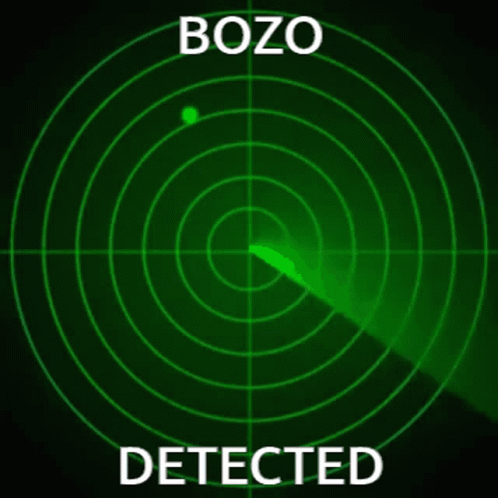

In [73]:
df_cleaned.to_csv('../data/processed/Periodic_Table_Cleaned.csv')